In [3]:
##Machine Learning Model Evaluations and Predictions 

In [93]:
import pandas as pd
import numpy as np
import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')

In [113]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from xgboost import XGBClassifier
from sklearn import metrics
from sklearn.metrics import roc_curve
from sklearn.metrics import recall_score, confusion_matrix, precision_score, f1_score, accuracy_score, classification_report
from sklearn.ensemble import AdaBoostClassifier  
from sklearn.ensemble import AdaBoostRegressor
from sklearn.metrics import confusion_matrix
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.ensemble import VotingClassifier

In [48]:
dfr=pd.read_csv(r"C:\Users\rashe\OneDrive\Telco Customer Churn.csv")

In [49]:
color_map = {"Yes": "#FF97FF", "No": "#AB63FA"}
fig = px.histogram(dfr, x="Churn", color="OnlineSecurity", barmode="group", title="<b>Churn distribution w.r.t OnlineSecurity<b>",color_discrete_map=color_map)
fig.update_layout(width=900, height=500, bargap=0.1)
fig.show()



In [50]:
color_map = {"Yes": "#FF97FF", "No": "#AB63FA"}
fig = px.histogram(dfr, x="Churn", color="PaperlessBilling", barmode="group", title="<b>Churn distribution w.r.t Paperless Billing<b>",color_discrete_map=color_map)
fig.update_layout(width=900, height=500, bargap=0.1)
fig.show()



In [51]:
color_map = {"Yes": "#FF97FF", "No": "#AB63FA"}
fig = px.histogram(dfr, x="Churn", color="TechSupport", barmode="group", title="<b>Churn distribution w.r.t Techsupport<b>",color_discrete_map=color_map)
fig.update_layout(width=900, height=500, bargap=0.1)
fig.show()



In [52]:
color_map = {"Yes": "#FF97FF", "No": "#AB63FA"}
fig = px.histogram(dfr, x="Churn", color="PhoneService", barmode="group", title="<b>Churn distribution w.r.t PhoneService<b>",color_discrete_map=color_map)
fig.update_layout(width=900, height=500, bargap=0.1)
fig.show()



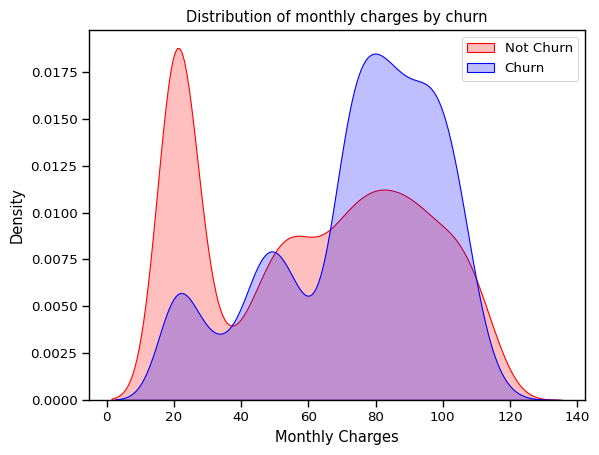

In [53]:
sns.set_context("paper",font_scale=1.1)
ax = sns.kdeplot(dfr.MonthlyCharges[(dfr["Churn"] == 'No') ],
                color="Red", shade = True);
ax = sns.kdeplot(dfr.MonthlyCharges[(dfr["Churn"] == 'Yes') ],
                ax =ax, color="Blue", shade= True);
ax.legend(["Not Churn","Churn"],loc='upper right');
ax.set_ylabel('Density');
ax.set_xlabel('Monthly Charges');
ax.set_title('Distribution of monthly charges by churn');

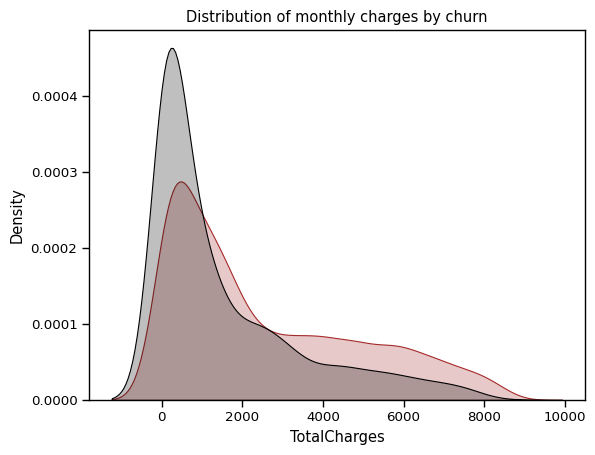

In [54]:
dfr['TotalCharges'] = pd.to_numeric(dfr['TotalCharges'], errors='coerce')
ax = sns.kdeplot(dfr.TotalCharges[(dfr["Churn"] == 'No') ],
                color="brown", shade=True)
ax = sns.kdeplot(dfr.TotalCharges[(dfr["Churn"] == 'Yes') ],
                ax=ax, color="black", shade=True)
ax.set_ylabel('Density');
ax.set_xlabel('TotalCharges');
ax.set_title('Distribution of monthly charges by churn');

In [55]:
fig = px.box(dfr, x='Churn', y = 'tenure')
fig.update_yaxes(title_text='Tenure (Months)', row=1, col=1)
fig.update_xaxes(title_text='Churn', row=1, col=1)
fig.update_layout(autosize=True, width=750, height=600,
    title_font=dict(size=25, family='Courier'),
    title='<b>Tenure vs Churn</b>',
)
fig.show()

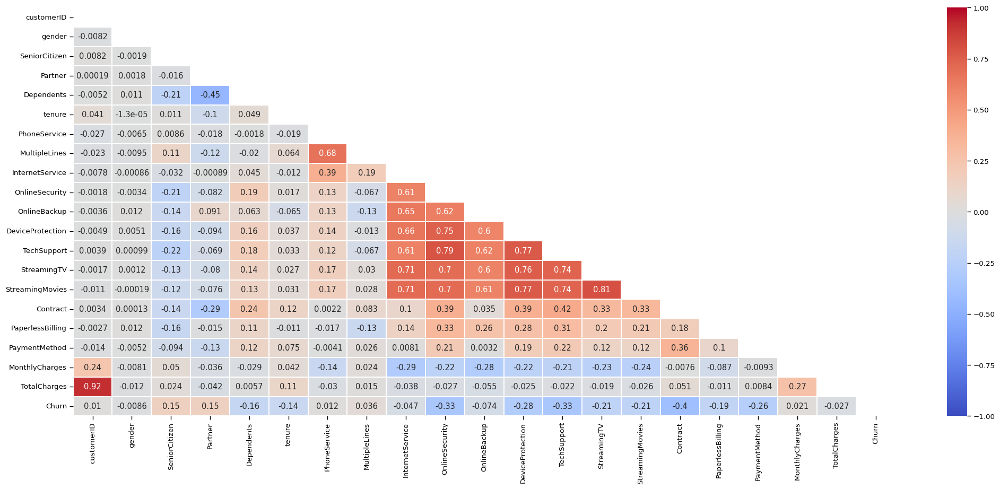

In [56]:
plt.figure(figsize=(25, 10))
corr = dfr.apply(lambda x: pd.factorize(x)[0]).corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
ax = sns.heatmap(corr, mask=mask, xticklabels=corr.columns, yticklabels=corr.columns, annot=True, linewidths=.2, cmap='coolwarm', vmin=-1, vmax=1)

In [57]:
dfr['TotalCharges']=pd.to_numeric(dfr.TotalCharges ,errors='coerce')
dfr.isnull().sum()


customerID           0
gender               0
SeniorCitizen        0
Partner              0
Dependents           0
tenure               0
PhoneService         0
MultipleLines        0
InternetService      0
OnlineSecurity       0
OnlineBackup         0
DeviceProtection     0
TechSupport          0
StreamingTV          0
StreamingMovies      0
Contract             0
PaperlessBilling     0
PaymentMethod        0
MonthlyCharges       0
TotalCharges        11
Churn                0
dtype: int64

In [58]:
dfr[np.isnan(dfr['TotalCharges'])]

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
488,4472-LVYGI,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,...,Yes,Yes,Yes,No,Two year,Yes,Bank transfer (automatic),52.55,NaN,No
753,3115-CZMZD,Male,0,No,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20.25,NaN,No
936,5709-LVOEQ,Female,0,Yes,Yes,0,Yes,No,DSL,Yes,...,Yes,No,Yes,Yes,Two year,No,Mailed check,80.85,NaN,No
1082,4367-NUYAO,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,25.75,NaN,No
1340,1371-DWPAZ,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,...,Yes,Yes,Yes,No,Two year,No,Credit card (automatic),56.05,NaN,No
3331,7644-OMVMY,Male,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,19.85,NaN,No
3826,3213-VVOLG,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,25.35,NaN,No
4380,2520-SGTTA,Female,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20.00,NaN,No
5218,2923-ARZLG,Male,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,One year,Yes,Mailed check,19.70,NaN,No
6670,4075-WKNIU,Female,0,Yes,Yes,0,Yes,Yes,DSL,No,...,Yes,Yes,Yes,No,Two year,No,Mailed check,73.35,NaN,No


In [59]:
dfr.fillna(dfr['TotalCharges'].mean())

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,...,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,...,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,...,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,6840-RESVB,Male,0,Yes,Yes,24,Yes,Yes,DSL,Yes,...,Yes,Yes,Yes,Yes,One year,Yes,Mailed check,84.80,1990.50,No
7039,2234-XADUH,Female,0,Yes,Yes,72,Yes,Yes,Fiber optic,No,...,Yes,No,Yes,Yes,One year,Yes,Credit card (automatic),103.20,7362.90,No
7040,4801-JZAZL,Female,0,Yes,Yes,11,No,No phone service,DSL,Yes,...,No,No,No,No,Month-to-month,Yes,Electronic check,29.60,346.45,No
7041,8361-LTMKD,Male,1,Yes,No,4,Yes,Yes,Fiber optic,No,...,No,No,No,No,Month-to-month,Yes,Mailed check,74.40,306.60,Yes


In [60]:
dfr[dfr['tenure']==0].index
dfr.drop(labels=dfr[dfr['tenure']==0].index,axis=0,inplace=True)
dfr[dfr['tenure']==0].index

Index([], dtype='int64')

In [61]:
dfr.isnull().sum()

customerID          0
gender              0
SeniorCitizen       0
Partner             0
Dependents          0
tenure              0
PhoneService        0
MultipleLines       0
InternetService     0
OnlineSecurity      0
OnlineBackup        0
DeviceProtection    0
TechSupport         0
StreamingTV         0
StreamingMovies     0
Contract            0
PaperlessBilling    0
PaymentMethod       0
MonthlyCharges      0
TotalCharges        0
Churn               0
dtype: int64

In [62]:
numerical_cols=['tenure','TotalCharges','MonthlyCharges']


In [63]:
def object_to_int(dataframe_series):
    if dataframe_series.dtype=='object':
        dataframe_series = LabelEncoder().fit_transform(dataframe_series)
    return dataframe_series


In [64]:
dfr = dfr.apply(lambda x: object_to_int(x))
dfr.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,5365,0,0,1,0,1,0,1,0,0,...,0,0,0,0,0,1,2,29.85,29.85,0
1,3953,1,0,0,0,34,1,0,0,2,...,2,0,0,0,1,0,3,56.95,1889.50,0
2,2558,1,0,0,0,2,1,0,0,2,...,0,0,0,0,0,1,3,53.85,108.15,1
3,5524,1,0,0,0,45,0,1,0,2,...,2,2,0,0,1,0,0,42.30,1840.75,0
4,6500,0,0,0,0,2,1,0,1,0,...,0,0,0,0,0,1,2,70.70,151.65,1


In [65]:
plt.figure(figsize=(14,7))
dfr.corr()['Churn'].sort_values(ascending = False)

Churn               1.000000
MonthlyCharges      0.192858
PaperlessBilling    0.191454
SeniorCitizen       0.150541
PaymentMethod       0.107852
MultipleLines       0.038043
PhoneService        0.011691
gender             -0.008545
customerID         -0.017858
StreamingTV        -0.036303
StreamingMovies    -0.038802
InternetService    -0.047097
Partner            -0.149982
Dependents         -0.163128
DeviceProtection   -0.177883
OnlineBackup       -0.195290
TotalCharges       -0.199484
TechSupport        -0.282232
OnlineSecurity     -0.289050
tenure             -0.354049
Contract           -0.396150
Name: Churn, dtype: float64

<Figure size 1400x700 with 0 Axes>

In [66]:
X = dfr.drop(columns = ['Churn'])
y = dfr['Churn'].values

In [67]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size = 0.30, random_state = 40, stratify=y)

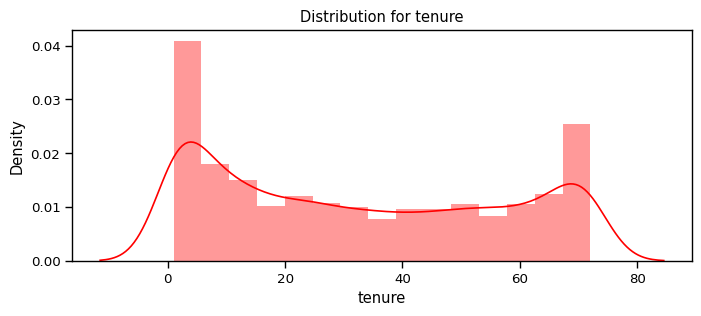

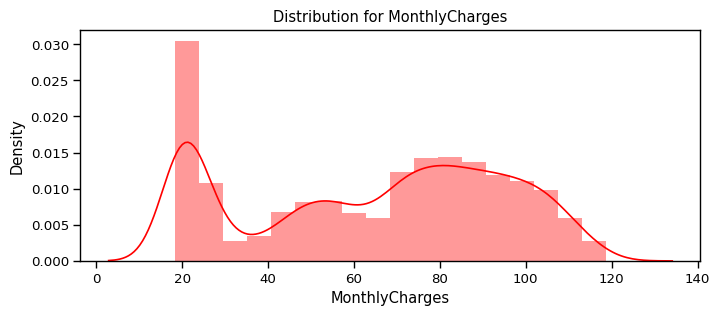

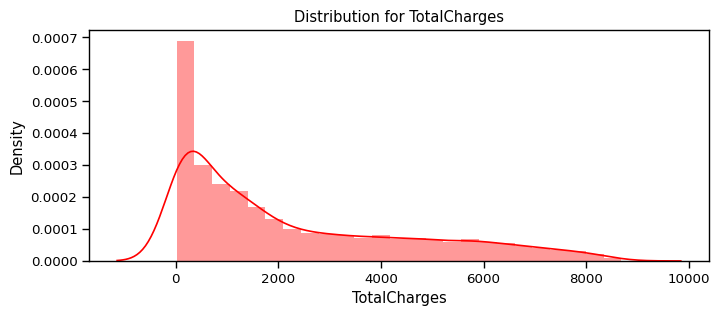

In [68]:
def distplot(feature, frame, color='r'):
    plt.figure(figsize=(8,3))
    plt.title("Distribution for {}".format(feature))
    ax = sns.distplot(frame[feature], color= color)
num_cols = ["tenure", 'MonthlyCharges', 'TotalCharges']
for feat in num_cols: distplot(feat, dfr)


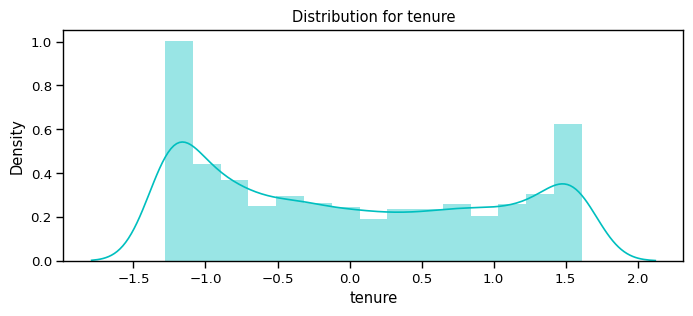

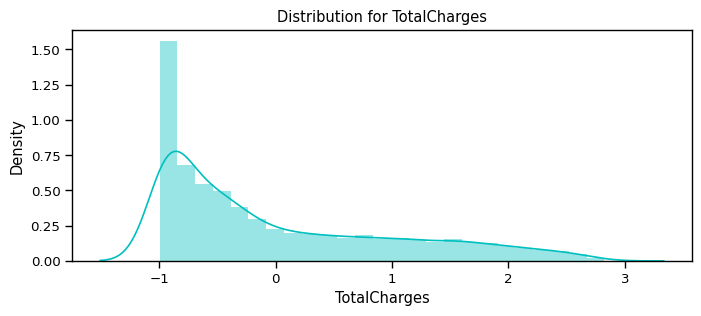

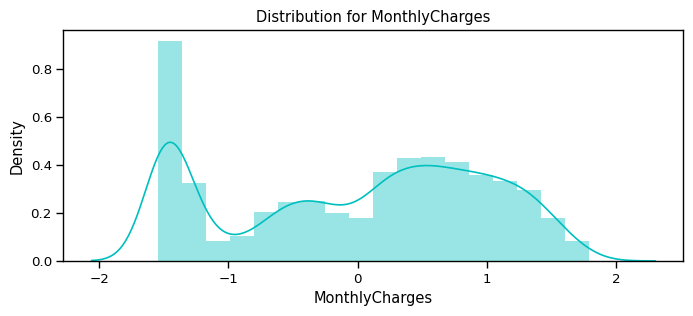

In [69]:
dfr_std = pd.DataFrame(StandardScaler().fit_transform(dfr[num_cols].astype('float64')),
                       columns=num_cols)
for feat in numerical_cols: distplot(feat, dfr_std, color='c')

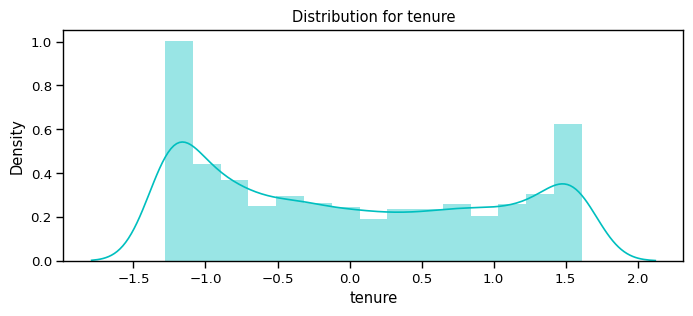

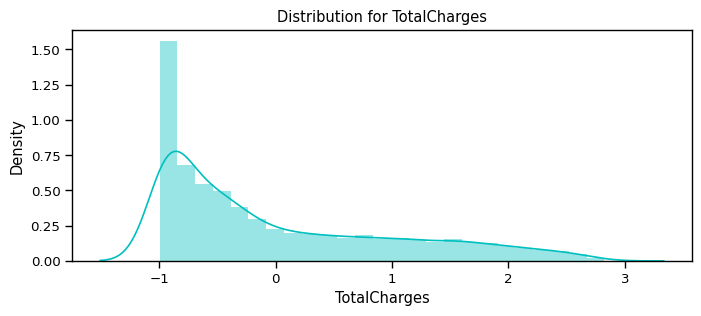

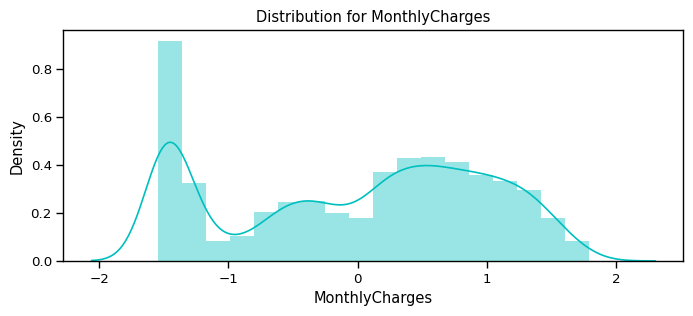

In [70]:
dfr_std = pd.DataFrame(StandardScaler().fit_transform(dfr[num_cols].astype('float64')),
                       columns=num_cols)
for feat in numerical_cols: distplot(feat, dfr_std, color='c')

In [71]:
cat_cols_ohe =['PaymentMethod', 'Contract', 'InternetService']
cat_cols_le = list(set(X_train.columns)- set(num_cols) - set(cat_cols_ohe))

In [95]:
scaler= StandardScaler()
X_train[num_cols] = scaler.fit_transform(X_train[num_cols])
X_test[num_cols] = scaler.transform(X_test[num_cols])

In [98]:
imputer = SimpleImputer(strategy='mean')
X_train_imputed = imputer.fit_transform(X_train)
X_test_imputed = imputer.transform(X_test)
knn_model = KNeighborsClassifier(n_neighbors=11)
knn_model.fit(X_train_imputed, y_train)
predicted_y = knn_model.predict(X_test_imputed)
accuracy_knn = accuracy_score(y_test, predicted_y)
print("KNN accuracy:", accuracy_knn)

KNN accuracy: 0.723696682464455


In [99]:
print(classification_report(y_test, predicted_y))


              precision    recall  f1-score   support

           0       0.74      0.96      0.84      1549
           1       0.39      0.07      0.12       561

    accuracy                           0.72      2110
   macro avg       0.56      0.51      0.48      2110
weighted avg       0.65      0.72      0.64      2110



In [100]:
svc_model = make_pipeline(
    SimpleImputer(strategy='mean'),
    StandardScaler(),          
    SVC(random_state=1, class_weight='balanced')
)
svc_model.fit(X_train, y_train)
predict_y = svc_model.predict(X_test)
accuracy_svc = svc_model.score(X_test, y_test)
print("SVM accuracy is:", accuracy_svc)

SVM accuracy is: 0.747867298578199


In [101]:
print(classification_report(y_test, predict_y))


              precision    recall  f1-score   support

           0       0.91      0.73      0.81      1549
           1       0.52      0.79      0.63       561

    accuracy                           0.75      2110
   macro avg       0.71      0.76      0.72      2110
weighted avg       0.80      0.75      0.76      2110



In [77]:
model_rf = RandomForestClassifier(n_estimators=500 , oob_score = True, n_jobs = -1,
                                  random_state =50, max_features = "sqrt",
                                  max_leaf_nodes = 30)
model_rf.fit(X_train, y_train)
prediction_test = model_rf.predict(X_test)
print (metrics.accuracy_score(y_test, prediction_test))

0.8099526066350711


In [78]:
print(classification_report(y_test, prediction_test))

              precision    recall  f1-score   support

           0       0.83      0.93      0.88      1549
           1       0.71      0.49      0.58       561

    accuracy                           0.81      2110
   macro avg       0.77      0.71      0.73      2110
weighted avg       0.80      0.81      0.80      2110



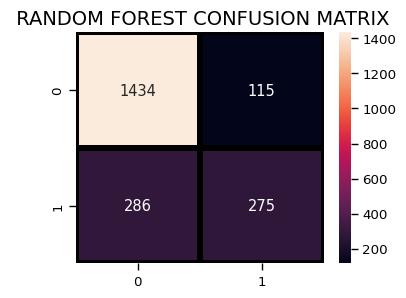

In [79]:
plt.figure(figsize=(4,3))
sns.heatmap(confusion_matrix(y_test, prediction_test),
                annot=True,fmt = "d",linecolor="k",linewidths=3)
    
plt.title(" RANDOM FOREST CONFUSION MATRIX",fontsize=14)
plt.show()


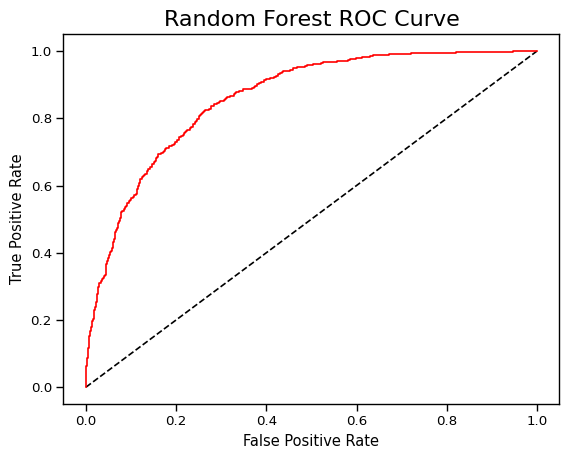

In [80]:
y_rfpred_prob = model_rf.predict_proba(X_test)[:,1]
fpr_rf, tpr_rf, thresholds = roc_curve(y_test, y_rfpred_prob)
plt.plot([0, 1], [0, 1], 'k--' )
plt.plot(fpr_rf, tpr_rf, label='Random Forest',color = "r")
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC Curve',fontsize=16)
plt.show() 

In [102]:
lr_model = make_pipeline(
    SimpleImputer(strategy='mean'),  
    StandardScaler(), 
    LogisticRegression(class_weight='balanced', random_state=1)  
)
lr_model.fit(X_train, y_train)
accuracy_lr = lr_model.score(X_test, y_test)
print("Logistic Regression accuracy is:", accuracy_lr)

Logistic Regression accuracy is: 0.7445497630331753


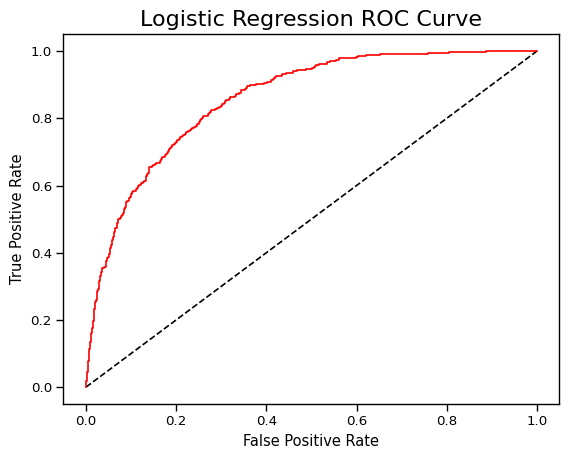

In [103]:
y_pred_prob = lr_model.predict_proba(X_test)[:,1]
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
plt.plot([0, 1], [0, 1], 'k--' )
plt.plot(fpr, tpr, label='Logistic Regression',color = "r")
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Logistic Regression ROC Curve',fontsize=16)
plt.show();

In [83]:
dt_model = DecisionTreeClassifier()
dt_model.fit(X_train,y_train)
predictdt_y = dt_model.predict(X_test)
accuracy_dt = dt_model.score(X_test,y_test)
print("Decision Tree accuracy is :",accuracy_dt)

Decision Tree accuracy is : 0.7222748815165877


In [84]:
print(classification_report(y_test, predictdt_y))


              precision    recall  f1-score   support

           0       0.82      0.79      0.81      1549
           1       0.48      0.52      0.50       561

    accuracy                           0.72      2110
   macro avg       0.65      0.66      0.65      2110
weighted avg       0.73      0.72      0.73      2110



In [109]:
gb = make_pipeline(
    SimpleImputer(strategy='mean'),  # Handles NaN
    GradientBoostingClassifier(
        n_estimators=100,
        learning_rate=0.1,
        max_depth=3,
        random_state=1
    )
)
gb.fit(X_train, y_train)
gb_pred = gb.predict(X_test)
print("Gradient Boosting Classifier Accuracy:", accuracy_score(y_test, gb_pred))

Gradient Boosting Classifier Accuracy: 0.804739336492891


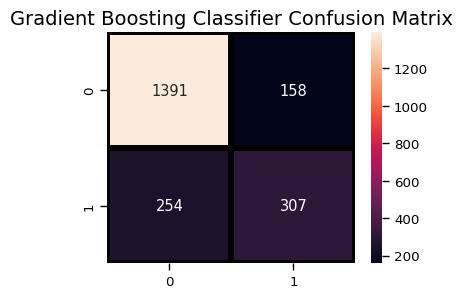

In [110]:
plt.figure(figsize=(4,3))
sns.heatmap(confusion_matrix(y_test, gb_pred),
                annot=True,fmt = "d",linecolor="k",linewidths=3)
    
plt.title("Gradient Boosting Classifier Confusion Matrix",fontsize=14)
plt.show()

In [111]:
print(classification_report(y_test, predictdt_y))


              precision    recall  f1-score   support

           0       0.82      0.79      0.81      1549
           1       0.48      0.52      0.50       561

    accuracy                           0.72      2110
   macro avg       0.65      0.66      0.65      2110
weighted avg       0.73      0.72      0.73      2110



In [114]:
clf1 = make_pipeline(
    SimpleImputer(strategy='median'), 
    GradientBoostingClassifier(
        n_estimators=100,
        learning_rate=0.1,
        max_depth=3,
        random_state=42
    )
)
clf2 = make_pipeline(
    SimpleImputer(strategy='median'),
    StandardScaler(), 
    LogisticRegression(
        max_iter=1000,  
        class_weight='balanced', 
        random_state=42
    )
)
clf3 = make_pipeline(
    SimpleImputer(strategy='median'),
    RandomForestClassifier(
        n_estimators=100,
        class_weight='balanced',
        random_state=42
    )
)
eclf1 = VotingClassifier(
    estimators=[
        ('gbc', clf1),  
        ('lr', clf2),  
        ('rfc', clf3)   
    ],
    voting='soft',  
    n_jobs=-1     
)
eclf1.fit(X_train, y_train)
predictions = eclf1.predict(X_test)
print("Final Accuracy Score: {:.2f}%".format(accuracy_score(y_test, predictions) * 100))

Final Accuracy Score: 80.05%


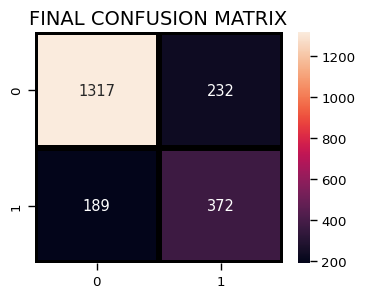

In [115]:
plt.figure(figsize=(4,3))
sns.heatmap(confusion_matrix(y_test, predictions),
                annot=True,fmt = "d",linecolor="k",linewidths=3)
    
plt.title("FINAL CONFUSION MATRIX",fontsize=14)
plt.show()